## Презентация (Project presentation)

 https://drive.google.com/file/d/1osqlZ0vI0YYmcLH3u3R4LHh4-FkKDUDf/view?usp=sharing

# Рынок заведений общественного питания Москвы

**Описание проекта**

   Исследование рынка заведений общественного питания в Москве для «Shut Up and Take My Money».

**Цель проекта** 

   Исследовать рынок заведений общественного питания в Москве, найти интересные особенности и презентовать
полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.


**В ходе проекта:**
- был проведен полный анализ всех заведений общественного питания в Москве
- было проведено более детальное исследование такого типо заведений, как КОФЕЙНИ
- подготовлена предентация с основными выводами и рекоментациями по результатам анализа.


____________________________________________________________________________________________________________________________
   
   *Исследование проводилось по данным датасета с заведениями общественного питания Москвы, составленного на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.*
____________________________________________________________________________________________________________________________


**Содержание проекта:**

1. [Загрузика данныx и изучение общей информации](#data_loading)
 * [Вывод по разделу](#conclusion1)
2. [Предобработка данных](#data_preprocessing)
 * [Вывод по разделу](#conclusion2)
3. [Анализ данных](#analysis)
 * [Вывод по разделу](#conclusion3)
4. [Детализированое исследование: открытие кофейни](#coffee_shops)
 * [Вывод по разделу](#conclusion4)    
5. [Презентация](#presentation)
6. [Итоги и выводы по результатам исследования](#general_conclusion)

<a id="data_loading"></a> 
## Загрузика данныx и изучение общей информации  

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import re 
import folium
from folium.plugins import MarkerCluster
from folium import Map, Marker, Choropleth
# подключаем модуль для работы с JSON-форматом
import json

df = pd.read_csv('moscow_places.csv')
original_length = len(df)
print('Первые 5 строк датафрейма')
df.head()

Первые 5 строк датафрейма


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [2]:
print('Общая информация: ')
df.info()

Общая информация: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [3]:
print('Описательная статистика:')
display(df.describe(include='all'))


Описательная статистика:


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406,8406,8406,8406,7870,8406.000000,8406.000000,8406.000000,3315,3816,3149.000000,535.000000,8406.000000,4795.000000
unique,5614,8,5753,9,1307,NaN,NaN,NaN,4,897,NaN,NaN,NaN,NaN
top,Кафе,кафе,"Москва, проспект Вернадского, 86В",Центральный административный округ,"ежедневно, 10:00–22:00",NaN,NaN,NaN,средние,Средний счёт:1000–1500 ₽,NaN,NaN,NaN,NaN
freq,189,2378,28,2242,759,NaN,NaN,NaN,2117,241,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,55.750109,37.608570,4.229895,NaN,NaN,958.053668,174.721495,0.381275,108.421689
std,NaN,NaN,NaN,NaN,NaN,0.069658,0.098597,0.470348,NaN,NaN,1009.732845,88.951103,0.485729,122.833396
min,NaN,NaN,NaN,NaN,NaN,55.573942,37.355651,1.000000,NaN,NaN,0.000000,60.000000,0.000000,0.000000
25%,NaN,NaN,NaN,NaN,NaN,55.705155,37.538583,4.100000,NaN,NaN,375.000000,124.500000,0.000000,40.000000
50%,NaN,NaN,NaN,NaN,NaN,55.753425,37.605246,4.300000,NaN,NaN,750.000000,169.000000,0.000000,75.000000
75%,NaN,NaN,NaN,NaN,NaN,55.795041,37.664792,4.400000,NaN,NaN,1250.000000,225.000000,1.000000,140.000000


In [4]:
print('Количество уникальных заведений: ')
print(df['name'].nunique())

Количество уникальных заведений: 
5614


<a id="conclusion1"></a> 

**Вывод по разделу "Загрузика данныx и изучение общей информации":**
- Всего в датасете представлено 8406 записей
- Количество уникальных заведений: 5614

**В таблице представленно 14 столбцов:**
- name — название заведения;
- address — адрес заведения;
- category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- hours — информация о днях и часах работы;
- lat — широта географической точки, в которой находится заведение;
- lng — долгота географической точки, в которой находится заведение;
- rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона, например
- middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
- middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
- chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки);
- district — административный район, в котором находится заведение, например Центральный административный округ;
- seats — количество посадочных мест.



*Все типы столбцов соответствуют предоставленной в них информации.*

<a id="data_preprocessing"></a>
## Предобработка данных

<div class="alert alert-info">Проверка дадасета на дубликаты по столбцам<b> "name" и "address"</b></div>

In [5]:
print('Количество дубликатов:')
df[['name','address']].duplicated().sum()

Количество дубликатов:


0

**Промежуточный вывод:**
- Дубликатов нет

In [6]:
print('Количество пропусков в столбцах')
df.isna().sum()

Количество пропусков в столбцах


name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [7]:
print('% пропусков в столбцах')
round(df.isna().mean(),2) * 100

% пропусков в столбцах


name                  0.0
category              0.0
address               0.0
district              0.0
hours                 6.0
lat                   0.0
lng                   0.0
rating                0.0
price                61.0
avg_bill             55.0
middle_avg_bill      63.0
middle_coffee_cup    94.0
chain                 0.0
seats                43.0
dtype: float64

**Промежуточный вывод:**


**Пропуски в столбцах:**
- **hours - 6 %**. Заполнять не будем. Пропусков не много и у каждого заведения свои часы работы. 
- **price - 61 %**. Очень большое количество пропусков. Пока не будем заполнять. Можно частично заполнить при наличии в информации в столбце avg_bill. Это еще + 6 %
- **avg_bill - 55 %** - Заполнять пока не будем.
- **middle_avg_bill - 63 %** - Много пропусков, так как нет информации в столбце avg_bill.
- **middle_coffee_cup - 94 %** - Много пропусков, так как нет информации в столбце avg_bill, и так как далеко не все заведения это КАФЕ. 
- **seats - 43 %**. Заполнять не будем. У каждого заведения индивидуальная вместимость.

**Значения в столбцах:**

Из описательной статистики видим очень большие максимальные значения в столбцах:
- seats - 148 мест
- middle_coffee_cup - 1568 руб
- middle_avg_bill - 35 000 руб

Выбросы это или нет будет разбираться в процессе анализа данных.

<div class="alert alert-info">Создание столбца <b>street</b> с названиями улиц из столбца с адресом.</div>

In [8]:
#функция ищет улицу в адресе при условии, что улица написана между первой и второй запятой в адресе или после первой запятой.
def street(address):
    try:
        return re.search(r'(?<=,\s)[^,]+(?=,)', address).group() 
    except:
        return re.search(r'(?<=,\s)[^,]+', address).group()

df['street'] = df['address'].apply(street)

#a = b.split(', ')[1] - запасной вариант как "вытянуть" улицы на случай если не использовать регулярки

<div class="alert alert-info">Создание столбца <b>is_24_7</b> с обозначением, что заведение работает ежедневно и круглосуточно (24/7)</div>

In [9]:
#функция для поиска в часах работы слов "ежедневно" и "круглосуточно"
def daily(hours):
    try:
        if 'ежедневно' in hours and 'круглосуточно' in hours:
            return True
        else:
            return False
    except:
        return 'no information' 
df['is_24_7'] = df['hours'].apply(daily)

display(df.head())

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False


<a id="conclusion2"></a> 
**Вывод по разделу "Предобработка данных":**
    
- дубликатов в записях нет
- пропуски есть в столбцах: hours(6 %), price(61 %), avg_bill(55 %), middle_avg_bill(63 %), middle_coffee_cup(94 %), seats(43 %).
- заполнять пропуски пока не будем, так как вся информация уникальна для каждого заведения.
- вероятнее всего есть выбросы в большую сторону в столбцах seats, middle_coffee_cup и middle_avg_bill. Выясним в ходе исследования.
- добавлен столбец **street** с названиями улиц
- добавлен столбец **is_24/7** с обозначением, что заведение работает ежедневно и круглосуточно (24/7)

<a id="analysis"></a> 
## Анализ данных

<div class="alert alert-info">Количество объектов общественного питания по категориям</div>

,category,count_places,%_of_all
0,кафе,2378,0.28
1,ресторан,2043,0.24
2,кофейня,1413,0.17
3,"бар,паб",765,0.09
4,пиццерия,633,0.08
5,быстрое питание,603,0.07
6,столовая,315,0.04
7,булочная,256,0.03


''

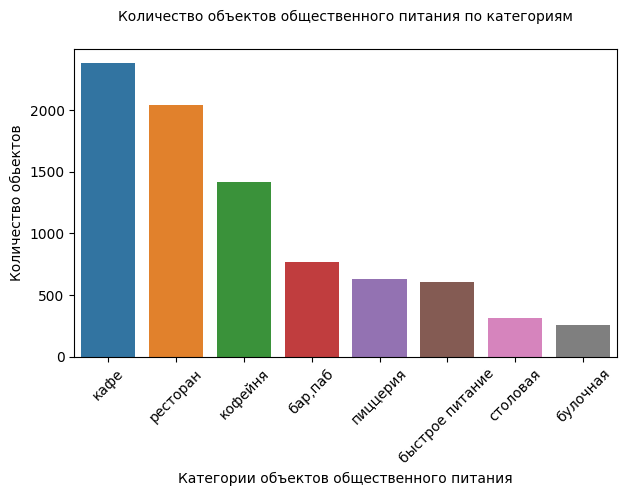

In [10]:
category = df.groupby('category').agg({'name':'count'}).sort_values(by = 'name',ascending = False).reset_index()
category=category.rename(columns={'name': 'count_places'})
category['%_of_all'] = round(category['count_places'] / category['count_places'].sum(),2)

display(category)

plt.figure(figsize=(7, 4))  
sns.barplot(x = 'category', y='count_places',  data=category)
plt.title('Количество объектов общественного питания по категориям',  size='medium', pad = 20)
plt.xlabel('Категории объектов общественного питания')
plt.ylabel('Количество обьектов')
plt.xticks(rotation=45)
,

**Промежуточный вывод:**
- самые частые категории заведений : КАФЕ, РЕСТОРАНЫ и КОФЕЙНИ. - это почти 70% всех заведений столицы.
- самая большая категория заведений с столице - КАФЕ. Более 2300 заведений и 28% от всех заведений.
- далее следует категория РЕСТОРАНЫ. Чуть больше 2000 заведений. (24% от всех заведений)
- КОФЕЙНИ - 1400 заведений. (17% от всех заведений) 
- БАРЫ, ПИЦЦЕРИИ, БЫСТРОЕ ПИТАНИЕ - от 600 до 750 заведений каждой категории.- в сумме 24% от всех заведений
- меньше всего в столице СТОЛОВЫХ и БУЛОЧНЫХ - 250-300 заведений каждой категории. - в сумме около 7%

<div class="alert alert-info">Количество посадочных мест в заведениях по категориям</div>

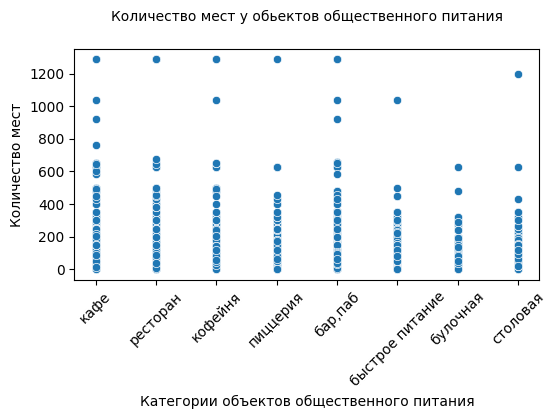

In [11]:
plt.figure(figsize=(6, 3))  
sns.scatterplot(x='category', y='seats', data=df)
plt.title('Количество мест у обьектов общественного питания',size='medium',  pad = 20)
plt.xlabel('Категории объектов общественного питания')
plt.ylabel('Количество мест')
plt.xticks(rotation=45)
plt.show()

**Промежуточный вывод:**
- Есть выбросы которые могут исказить результаты. Поэтому уберем из базы все заведения у которых количество мест больше чем 350. Это уберет большинство выбросов.

<div class="alert alert-info">Удаление выбросов в столбце seats</div>

Количество строк ДО удаление выбросов: 8406
Количество строк ПОСЛЕ удаление выбросов: 8209


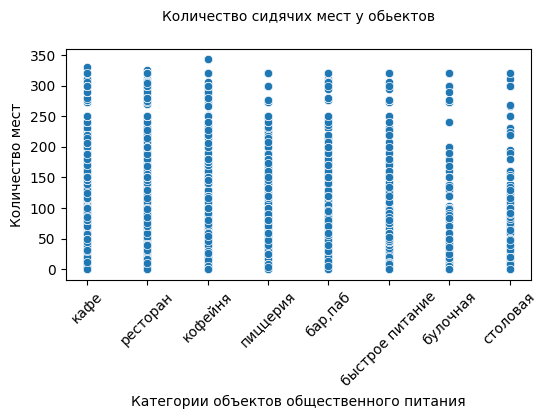

''

In [12]:
df = df.query('seats < 350 or seats.isnull()')

print(f'Количество строк ДО удаление выбросов: {original_length}')
print(f'Количество строк ПОСЛЕ удаление выбросов: {len(df)}')


plt.figure(figsize=(6, 3))  
sns.scatterplot(x='category', y='seats', data=df,)
plt.title('Количество сидячих мест у обьектов', size='medium', pad = 20)
plt.xlabel('Категории объектов общественного питания')
plt.ylabel('Количество мест')
plt.xticks(rotation=45)
plt.show()
,

<div class="alert alert-info">Количество посадочных мест в местах по категориям (после удаление выбросов) </div>

,category,median,mean
0,"бар,паб",80.0,97.0
6,ресторан,80.0,102.0
4,кофейня,72.0,94.0
7,столовая,72.0,84.0
2,быстрое питание,60.0,89.0
3,кафе,58.0,80.0
5,пиццерия,50.0,81.0
1,булочная,50.0,83.0


''

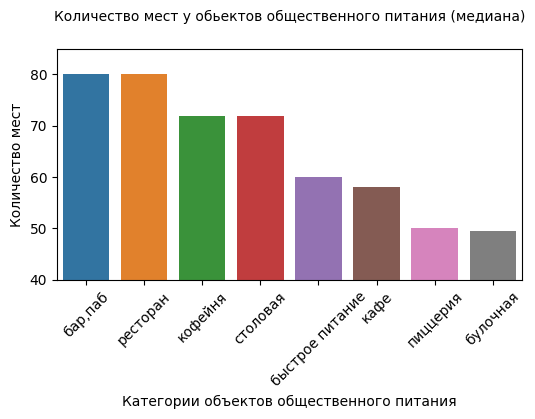

In [13]:
seats = df.groupby('category').agg({'seats':['median','mean']}).droplevel(level=0, axis=1).reset_index().sort_values(by = 'median',ascending = False)
display(round(seats))

plt.figure(figsize=(6, 3)) 
sns.barplot(x = 'category', y='median',  data=seats)
plt.title('Количество мест у обьектов общественного питания (медиана)', size='medium', pad = 20)
plt.xlabel('Категории объектов общественного питания')
plt.ylabel('Количество мест')
plt.ylim(40, 85)
plt.xticks(rotation=45)
,

**Промежуточный вывод:**
- даже после удаления выбросов СРЕДНЕЕ весомо выше МЕДИАНЫ. Есть весомый разброс по количеству мест у заведений в бОльшую сторону. Поэтому для графика и дальнейшего анализа будем использовать МЕДИАНУ.
- больше всего посадочных мест у : РЕСТОРАНОВ, БАРОВ, КОФЕЕН и СТОЛОВЫХ. - от 70 до 80.
- у ресторанов БЫСТРОГО ПИТАНИЯ и КАФЕ - около 60 мест.
- в ПИЦЦЕРИЯХ и БУЛОЧНЫХ - 50 мест.

<div class="alert alert-info">Соотношение сетевых и несетевых заведений в датасете </div>

''

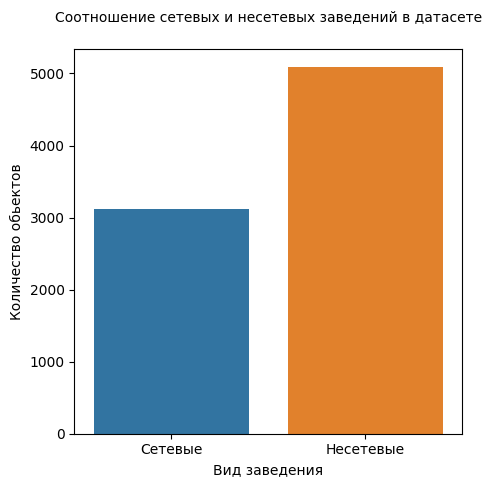

In [14]:
df['chain'] = df['chain'].replace(0,'Несетевые')
df['chain'] = df['chain'].replace(1,'Cетевые')

chain=df.groupby('chain').agg({'name':'count'}).reset_index()

plt.figure(figsize=(5, 5)) 
sns.barplot(x='chain', y='name', data = chain)
plt.title('Соотношение сетевых и несетевых заведений в датасете', size='medium', pad = 20)
plt.xlabel('Вид заведения')
plt.ylabel('Количество обьектов')
,

**Промежуточный вывод:**
- Сетевых заведений - около 3 тыс. - 37,5% от всех заведений
- НЕсетевых больше - около 5 тыс. - 62,5% от всех заведений

<div class="alert alert-info">Какие категории заведений чаще являются сетевыми? </div>

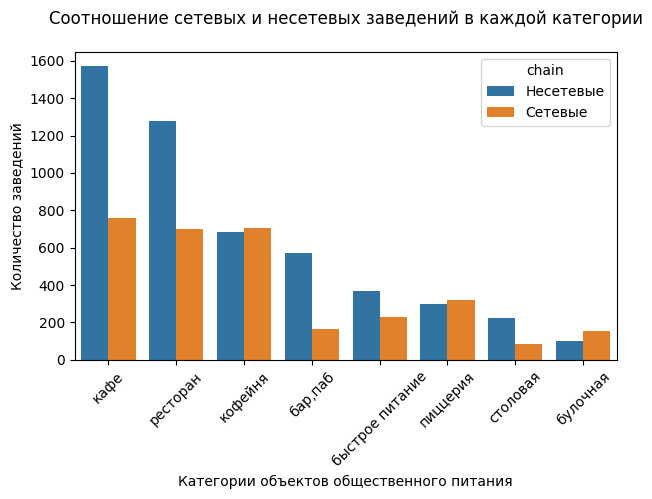

=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-


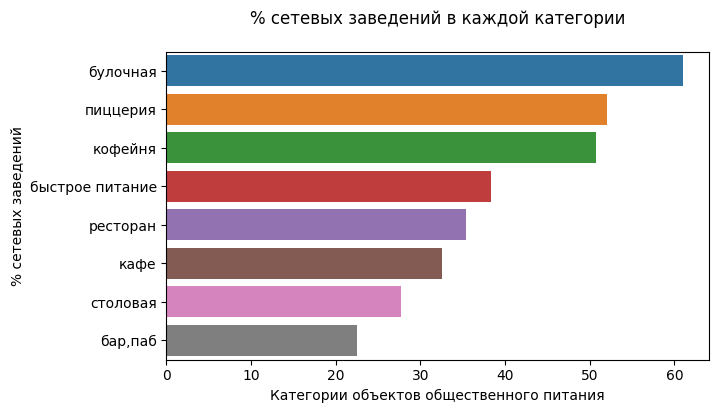

''

In [15]:
chain_category = df.groupby(['category', 'chain']).agg({'name':'count'}).reset_index().sort_values(by = 'name',ascending = False)

plt.figure(figsize=(7, 4)) 
sns.barplot(x = 'category', y='name',  data=chain_category, hue ='chain')
plt.title('Соотношение сетевых и несетевых заведений в каждой категории', pad = 20)
plt.xlabel('Категории объектов общественного питания')
plt.ylabel('Количество заведений')
plt.xticks(rotation=45)
plt.show()
,
#создаем табличку для расчета доли сетевых заведений в категории 
share_of_chain = df.groupby(['category']).agg({'name':'count'}).reset_index(
).merge(chain_category.query('chain=="Cетевые"'), on='category',how='inner')
share_of_chain = share_of_chain.rename(columns={'name_x': 'all','name_y':'count_chain'})
share_of_chain['share_of_chain']=share_of_chain['count_chain']/share_of_chain['all']*100
share_of_chain = share_of_chain.sort_values(by = 'share_of_chain',ascending = False)

print(60*'=-')

plt.figure(figsize=(7, 4)) 
sns.barplot(y = 'category', x='share_of_chain',  data=share_of_chain)
plt.title('% сетевых заведений в каждой категории', pad = 20)
plt.xlabel('Категории объектов общественного питания')
plt.ylabel('% сетевых заведений')
plt.show()
,

**Промежуточный вывод:**

- Самая высокая ДОЛЯ сетевых заведений у БУЛОЧНЫХ(около 60%), ПИЦЦЕРИЙ(около 50%) и КОФЕЕН(около 50%).
- Самая маленькая доля сетевых заведений у БАРОВ (чуть больше 20%)


<div class="alert alert-info">Популярные сетевые заведения Москвы. Топ-15 </div>

Популярные сетевые заведения Москвы. Топ-15


,name,count_places
744,Шоколадница,117
342,Домино'с Пицца,76
338,Додо Пицца,73
146,One Price Coffee,69
757,Яндекс Лавка,67
58,Cofix,64
168,Prime,48
677,Хинкальная,44
376,КОФЕПОРТ,40
429,Кулинарная лавка братьев Караваевых,38


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=


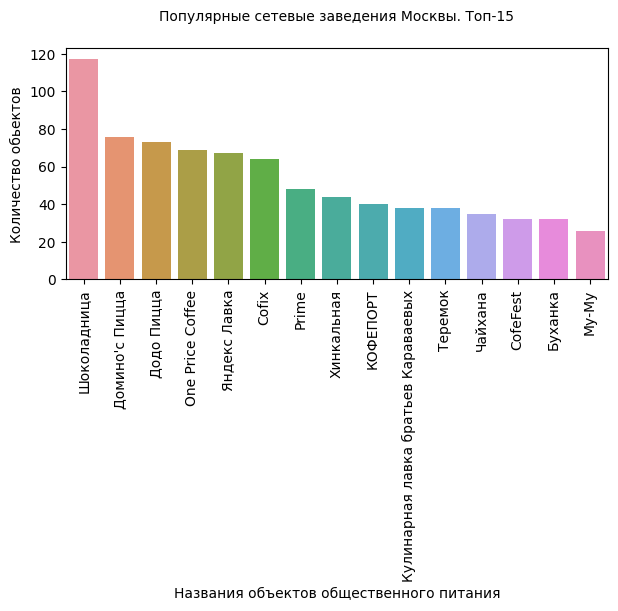

''

In [16]:
print('Популярные сетевые заведения Москвы. Топ-15')
top_chain = df.query('chain == "Cетевые"').groupby(['name']).agg({'address':'count'}).reset_index(
).sort_values(by='address', ascending=False).head(15)
top_chain=top_chain.rename(columns={'address': 'count_places'})

display(top_chain)
print(60*'-=')

plt.figure(figsize=(7, 3)) 
sns.barplot(x = 'name', y='count_places',  data=top_chain)
plt.title('Популярные сетевые заведения Москвы. Топ-15', size='medium', pad = 20)
plt.xlabel('Названия объектов общественного питания')
plt.ylabel('Количество обьектов')
plt.xticks(rotation=90)
plt.show()
,

**Промежуточный вывод:**

 ТОП 15 сетевыми заведениями Москвы, по количеству точек, являются:
 
**КОФЕЙНИ:**
- Шоколадница - 117 заведений
- One Price Coffee - 69 заведений
- Cofix - 64 заведения
- КОФЕПОРТ - 40 заведений
- CofeFest - 32 заведение


**ПИЦЦЕРИИ:**
- Домино'с Пицца - 76 заведений
- Додо Пицца - 73 заведений

**РЕСТОРАНЫ:**
- Яндекс Лавка - 67 заведений
- Prime - 48 заведений
- Теремок - 38 заведений

**КАФЕ:**
- Му-МУ - 26 заведений
- Хинкальная - 44 заведения
- Кулинарная лавка братьев Караваевых - 38 заведений
- Чайхана - 35 заведений


**БУЛОЧНЫЕ:**
- Буханка - 32 заведений

<div class="alert alert-info">Категории к которым относятся популярные сетевых заведений Москвы из Топ-15 </div>

In [17]:
print(60*'-=')
print('Какие категории входят в топ 15 сетевых заведений:')
category_top_chain = df.query('name in @top_chain.name').groupby(['category']).agg({'name':'count'}).reset_index(
).sort_values(by = 'name',ascending = False)
category_top_chain=category_top_chain.rename(columns={'name': 'count'})
print(60*'-=')

fig = px.bar(category_top_chain.sort_values(by='count'),
             y='category',
             x='count',
             text='count',
             width=800, height=400                   
            )

fig.update_layout(title='Категории популярных сетевых заведений Москвы.',
                   yaxis_title='Категории объектов общественного питания',
                   xaxis_title='Количество обьектов')
fig.show() 

-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
Какие категории входят в топ 15 сетевых заведений:
-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=


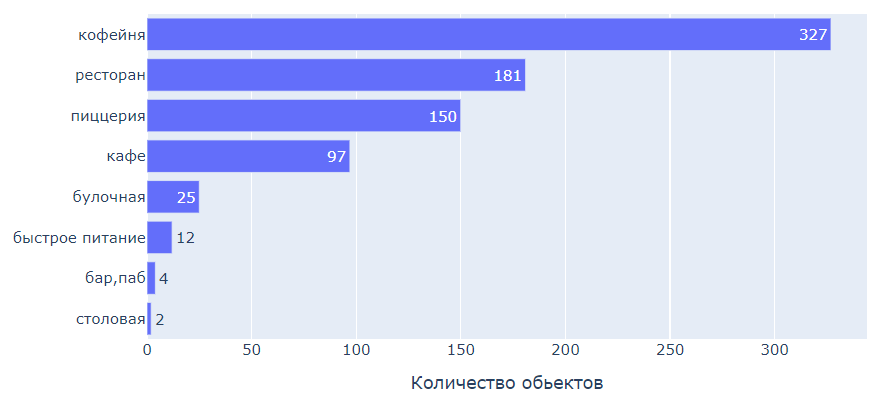

**Промужуточный вывод:**
- Самая многочисленная категория *среди популярных сетевых заведений* - это КОФЕЙНИ - 341 точка.
- Далее следуют РЕСТОРАНЫ и ПИЦЦЕРИИ - по 150 точек на каждую категорию.
- Сетевых КАФЕ и булочных - поменьше. КАФЕ - 87 точек, БУЛОЧНЫХ - только 25.

<div class="alert alert-info">Распределение популярных сетевых заведений по районам </div>

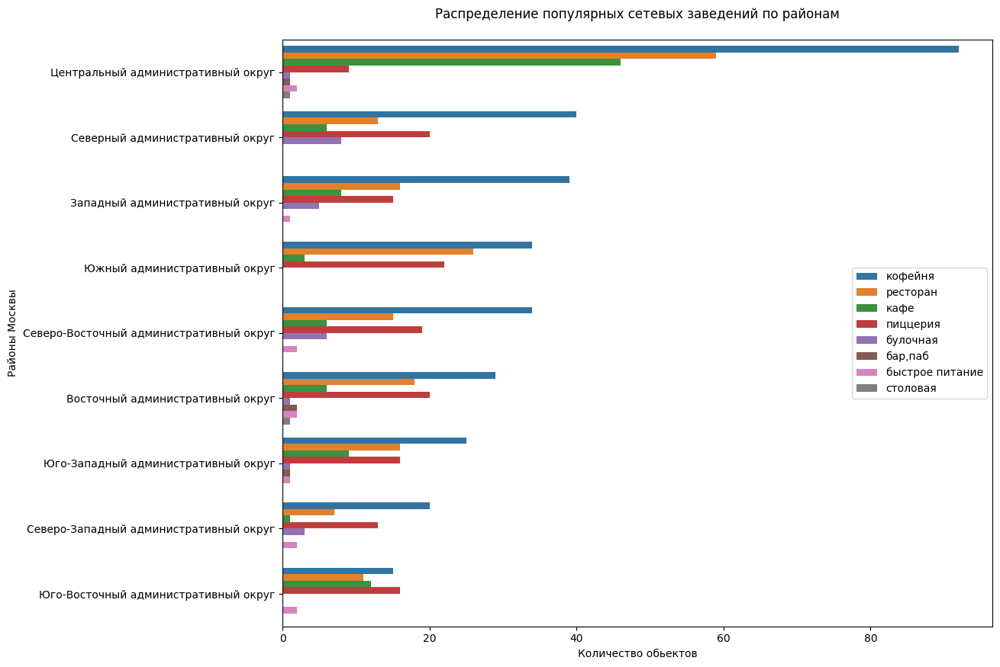

In [18]:
top_15_df = df.query('name in @top_chain.name')
district = top_15_df.groupby(['district','category']).agg({'name':'count'}).reset_index()
district=district.rename(columns={'name': 'count_places'})


plt.figure(figsize=(12, 10)) 
sns.barplot(y = 'district', x='count_places',  data=district.sort_values(by='count_places', ascending = False), hue='category')
plt.title('Распределение популярных сетевых заведений по районам', pad = 20)
plt.xlabel('Количество обьектов')
plt.ylabel('Районы Москвы')
plt.legend(loc='center right') 
plt.show()

**Промежуточный вывод:**
- в КАЖДОМ округе, кроме **Юго-Восточного** -  преобладает количество кофеен над другими категориями заведений. В Юго-Восточном -всего 15 кофеен. Вероятно это точка роста для округа, учитывая популярность данной категории. Так же тут нет сетевых точек быстрого питания и булочных.
- В **Северо - западном** округе практически нет сетевых КАФЕ(1 место). Сетевых ресторанов представлено намного меньше, чем в других округах.
- В **Юго-западном** отсутствуют сетевые точки быстрого питания. и только 1 точка категории БУЛОЧНЫЕ.
- В **Восточном** округе - практически нет сетевых КАФЕ(2 места) и отсутствуют сетевые точки быстрого питания. и только 1 точка категории БУЛОЧНЫЕ.
- в **Южном** округе нет сетевых точек быстрого питания и булочных. 
- в **Северо-восточном и Западном** округах есть все категории сетевых популярных заведений.
- в **Северном** округе отсутствуют сетевые точки быстрого питания.
- в **Центральном** округе КОФЕЕН, ресторанов и кафе примерно в 2-3 раза больше чем в других округах, что закономерно - это центр города. Зато пиццерий, булочных и быстрого питания меньше чем в остальных районах.

<div class="alert alert-info">Распределение ВСЕХ заведений по районам (с разделением по категориям) </div>

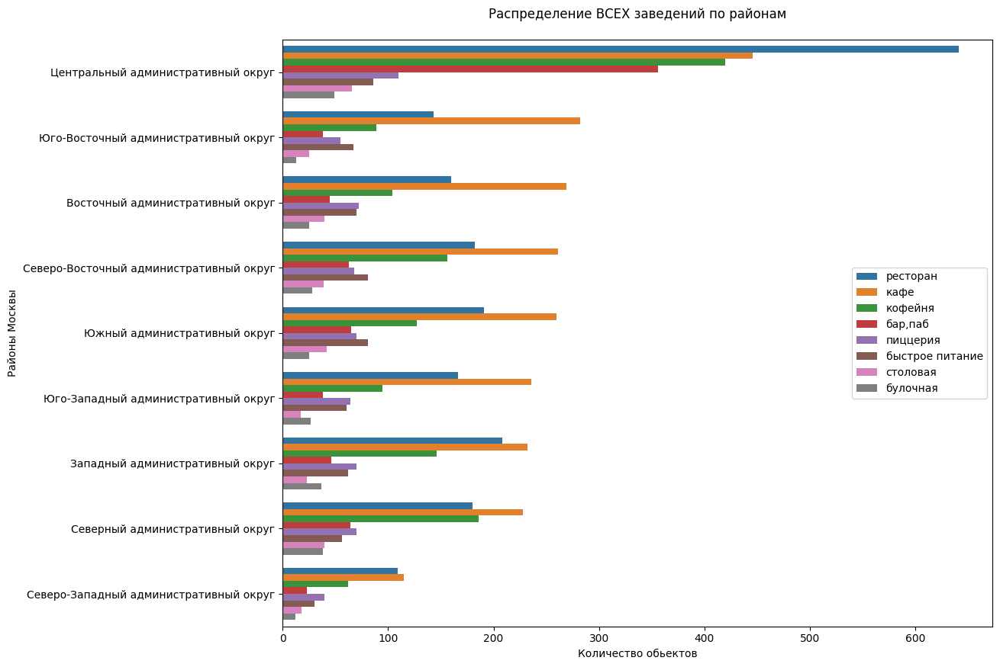

In [19]:
group_df = df.groupby(['district','category']).agg({'name':'count'}).reset_index()
group_df=group_df.rename(columns={'name': 'count_places'})


plt.figure(figsize=(12, 10)) 
sns.barplot(y = 'district', x='count_places',  data=group_df.sort_values(by='count_places', ascending = False), hue='category')
plt.title('Распределение ВСЕХ заведений по районам', pad = 20)
plt.xlabel('Количество обьектов')
plt.ylabel('Районы Москвы')
plt.legend(loc='center right')
plt.show()

**Промежуточный вывод:**
- по сравнению с прошлым графиком доля КОФЕЕН, относительно других категорий, сильно снизилась, что говорит о том, что большинство КОФЕЕН - это сети. А вот ресторанов и кафе много НЕсетевых или состоящих в маленьких сетях.
- в целом соотношение заведений по округам примерно одинаковое, за исключением Центрального округа и Северозападного.
- в Центральном ВСЕХ категорий заведений в разы больше, что закономерно. В Северозападном - намного меньше, чем в остальных округах.

<div class="alert alert-info">Рейтинги заведений по категориям</div>

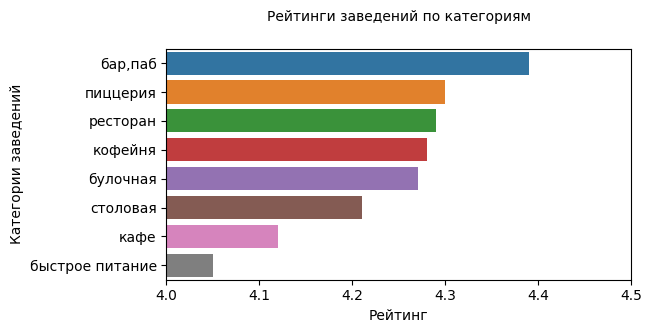

In [20]:
rating = df.groupby('category').agg({'rating':'mean'}).reset_index().sort_values(by='rating', ascending = False)
rating['rating'] = round(rating['rating'],2)

plt.figure(figsize=(6, 3)) 
sns.barplot(x = 'rating', y='category',  data=rating)
plt.title('Рейтинги заведений по категориям', size='medium', pad = 20)
plt.xlabel('Рейтинг')
plt.ylabel('Категории заведений')
plt.xlim(4, 4.5)
plt.show()

**Промежуточный вывод:**
- Разброс средних рейтингов у разных категорий заведений НЕБОЛЬШОЙ. от 4 до 4,4.
- Самые высокие рейтинги у БАРОВ
- Самые низкие у БЫСТРОГО ПИТАНИЯ.

<div class="alert alert-info">Картограмма со средним рейтингом заведений каждого района.</div>

In [21]:
rating_df = df.groupby('district').agg({'rating':'mean'}).reset_index()

# загружаем JSON-файл с границами округов Москвы
with open('admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
    state_geo = json.load(f)

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

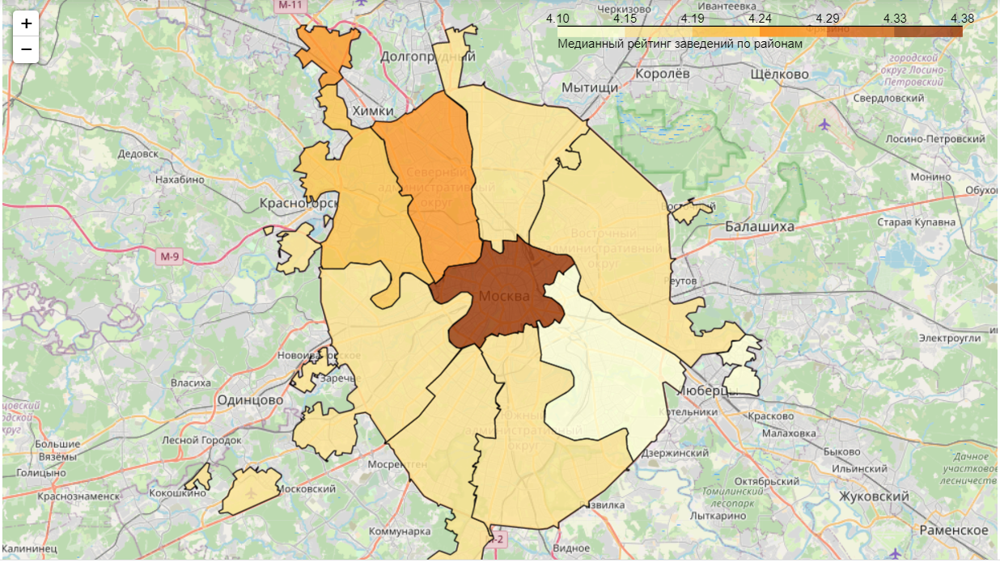

**Промежуточный вывод:**
- Самый высокий средний рейтинг у Центрального округа.
- Далее идет Северный и Северозападный округ.
- Самые низкие рейтинги у Южно-восточного округа.

<div class="alert alert-info">Карта со всеми заведениями Москвы с названием и рейтингом</div>

In [22]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

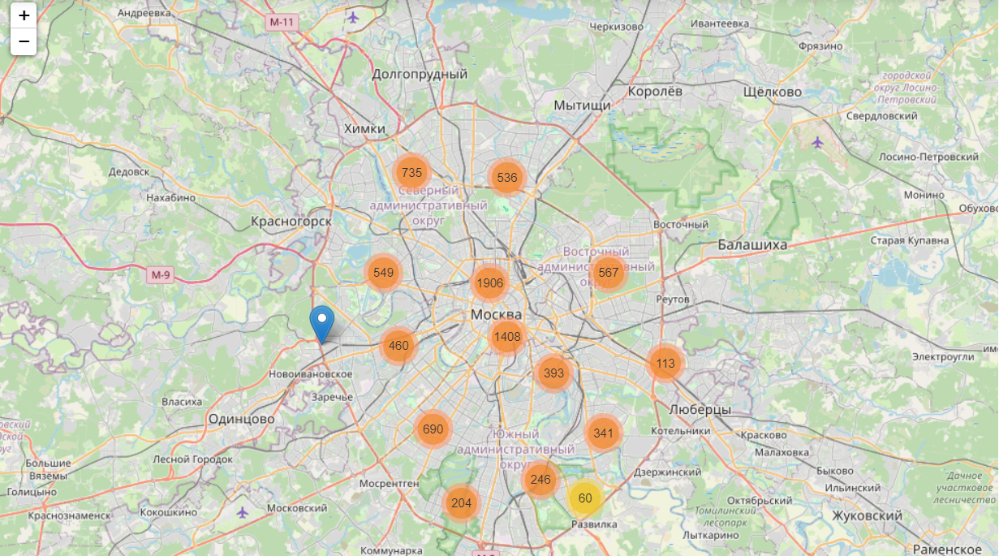

<div class="alert alert-info">Топ-15 улиц по количеству заведений</div>

In [23]:
top_streets = df.groupby(['street']).agg({'name':'count'}).reset_index(
).sort_values(by='name', ascending=False).head(15)

top_streets_category = df.query('street in @top_streets.street').groupby(['street','category']).agg({'name':'count'}).reset_index(
).sort_values(by='name', ascending=False)
top_streets_category=top_streets_category.rename(columns={'name': 'count_places'})


fig = px.bar(top_streets_category,
             y='street',
             x='count_places',
             color='category',
             text='count_places',
             width=1000, height=500                   
            )

fig.update_layout(title='Топ-15 улиц по количеству заведений',
                   yaxis_title='Улица',
                   xaxis_title='Количество обьектов',
                   yaxis={'categoryorder':'total ascending'})

fig.show()

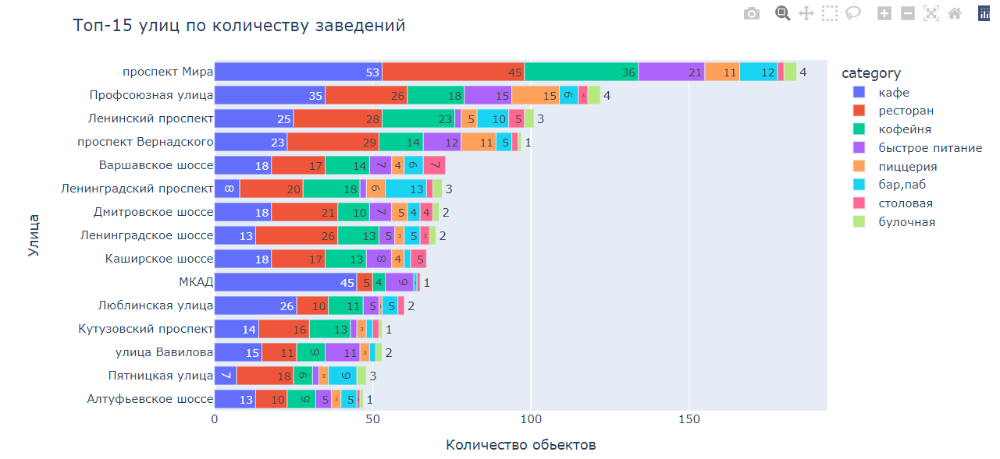

**Промежуточный вывод:**

Самые популярные улицы по количеству заведений:
- проспект Мира - 184 заведения
- Профсоюзная улица - 122 заведения
- Ленинский проспект - 101 заведение
- проспект Вернадского - 97 заведений
- Варшавское шоссе - 73 заведения
- Ленинградский проспект - 72 заведения
- Дмитровское шоссе - 71 заведение
- Ленинградское шоссе - 70 заведений
- Каширское шоссе - 67 заведений 
- МКАД - 65 заведений 
- Люблинская улица - 60 заведений 
- Кутузовский проспект - 53 заведения
- улица Вавилова - 53 заведения
- Пятницкая улица - 48 заведений
- Алтуфьевское шоссе - 47 заведений 

<div class="alert alert-info">Обьекты, которые являются единственными заведениями питания на улицах.</div>

In [24]:
streets_one_place = df.groupby(['street']).agg({'name':'count'}).reset_index(
).sort_values(by='name', ascending=False).query('name==1')
streets_one_place_name = df.query('street in @streets_one_place.street')
display(streets_one_place_name.groupby('category').agg({'name':'count'}).reset_index().sort_values(by='name', ascending = False))


,category,name
3,кафе,160
6,ресторан,93
4,кофейня,85
0,"бар,паб",39
7,столовая,36
2,быстрое питание,23
5,пиццерия,15
1,булочная,8


**Промужуточный вывод:**
- на улицах где есть только 1 заведение - это чаще всего КАФЕ. - в 160 случаях.
- на втором и третьем месте по частоте - РЕСТОРАНЫ - на 93ех улицах и КАФЕЙНИ на 85ти улицах.

<div class="alert alert-info">Расположение на карте этих обьектов(единственных на улицах)</div>

In [25]:
# создаём карту Москвы
m_one_place = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster_for_streets_one_place = MarkerCluster().add_to(m_one_place)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters_2(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster_for_streets_one_place)

# применяем функцию create_clusters() к каждой строке датафрейма
streets_one_place_name.apply(create_clusters_2, axis=1)

# выводим карту
m_one_place

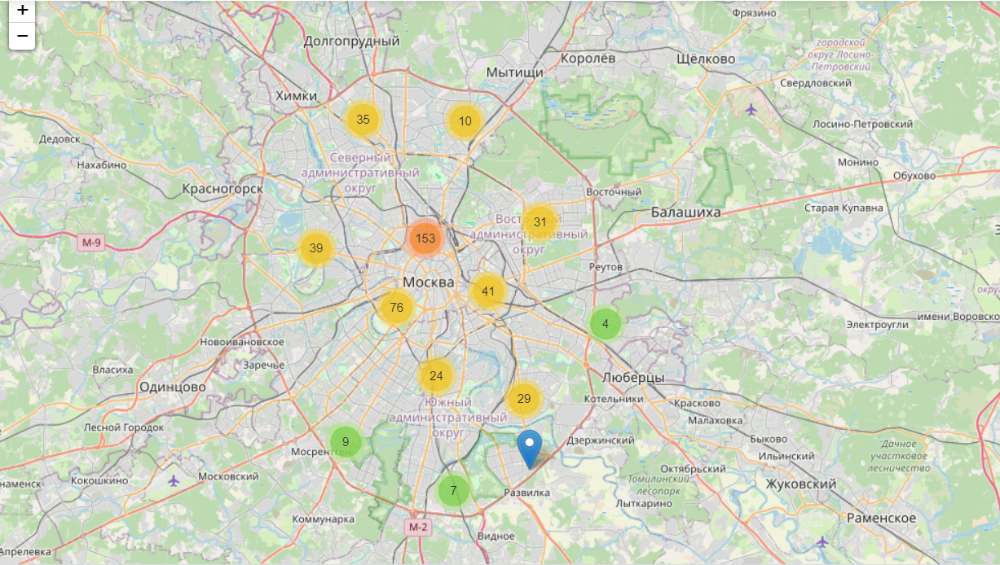

**Промежуточный вывод:**
- Обьекты распределены по карте примерно так же как и остальные. В центре чаще - по окраинам - реже. Это может быть связано с тем, что в центре много маленьких улочек.

<div class="alert alert-info">Медианный чек заведений</div>

,category,middle_avg_bill
0,"бар,паб",1250.0
6,ресторан,1250.0
5,пиццерия,600.0
3,кафе,550.0
1,булочная,442.5
4,кофейня,400.0
2,быстрое питание,375.0
7,столовая,300.0


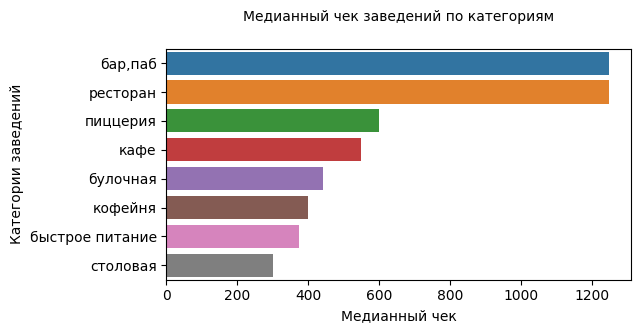

In [26]:
middle_avg_bill = df.groupby('category').agg({'middle_avg_bill':'median'}).reset_index().sort_values(by='middle_avg_bill', ascending = False)
display(middle_avg_bill)

plt.figure(figsize=(6, 3)) 
sns.barplot(x = 'middle_avg_bill', y='category',  data=middle_avg_bill)
plt.title('Медианный чек заведений по категориям', size='medium', pad = 20)
plt.xlabel('Медианный чек')
plt.ylabel('Категории заведений')
#plt.xlim(4, 4.5)
plt.show()

**Промежуточный вывод:**
- Самые высокие чеки у баров и ресторанов - 1100-1150руб
- Кафе и пиццерии - 525-600 руб
- Кафейни и булочные - 400-425 руб
- Столовые и быстрое питание 300-337 руб

<div class="alert alert-info">Медианный чек заведений в зависимости от района по категориям</div>

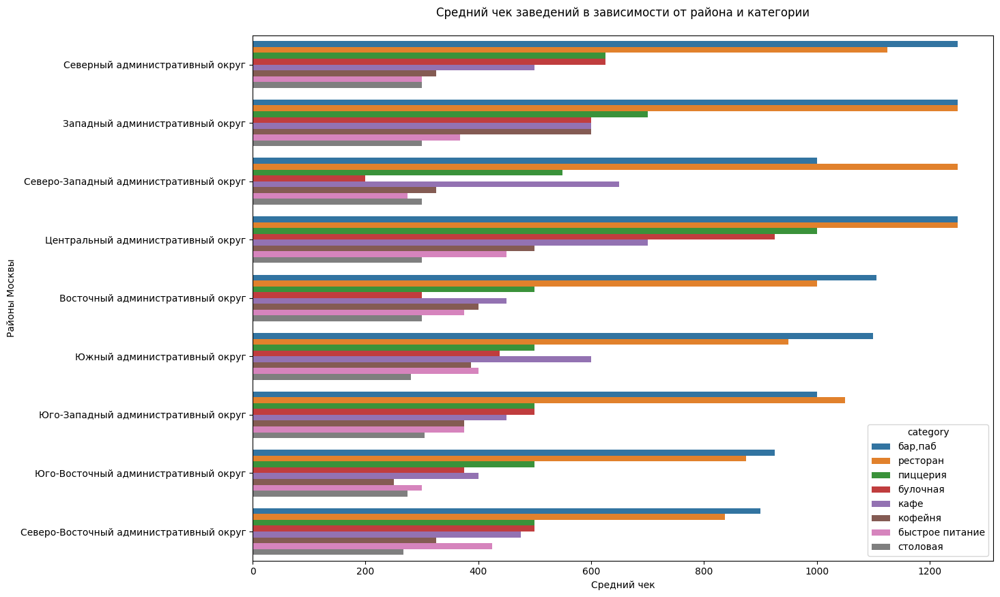

In [27]:
middle_avg_bill_category = df.groupby(['district','category']).agg({'middle_avg_bill':'median'}).reset_index()

plt.figure(figsize=(14, 10)) 
sns.barplot(y = 'district', x='middle_avg_bill',  data=middle_avg_bill_category.sort_values(by='middle_avg_bill', ascending = False), hue='category')
plt.title('Средний чек заведений в зависимости от района и категории', pad = 20)
plt.xlabel('Средний чек')
plt.ylabel('Районы Москвы')
plt.show()

- во всех округах самые высокие средние чеки у баров и ресторанов.
- В Центральном округе средний чек в барах, ресторанах ,булочных, пиццериях намного выше чем в других округах.
- Быстрое питание, столовые и кафейне во всех округах примерно на одном ценовом уровне.

<div class="alert alert-info">Средний чек заведений в зависимости от района на карте</div>

In [28]:
middle_avg_bill = df.groupby(['district']).agg({'middle_avg_bill':'median'}).reset_index()

# создаём карту Москвы
m_bill= Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
    legend_name='Медианный чек заведений по районам',
).add_to(m_bill)

# выводим карту
m_bill

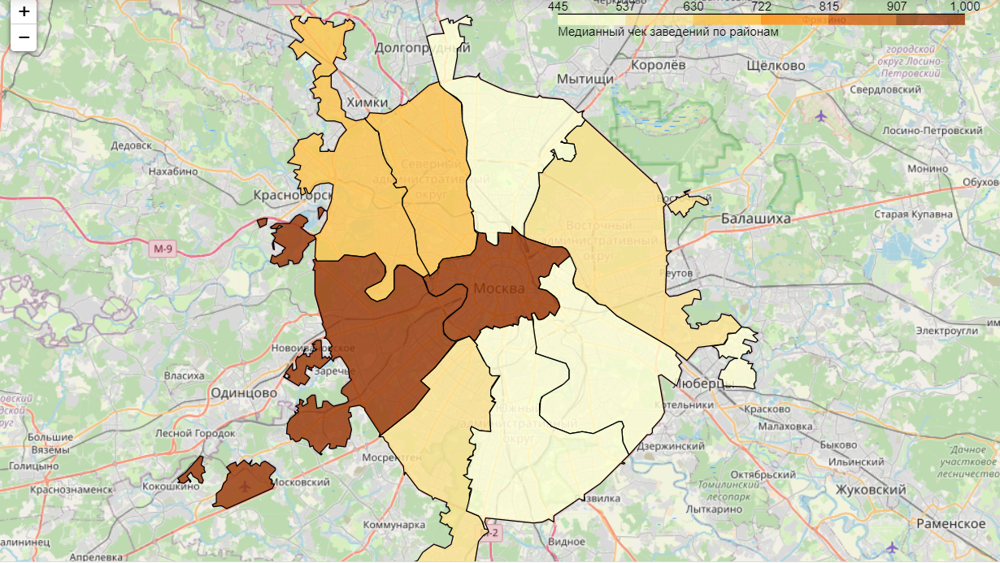

**Промежуточный вывод:**
- На карте видим, что самый высокий средний чек в Центральном и Западном округах
- Северный и Северозападный - чуть пониже. 
- еще ниже - Восточный и Юго-западный округа.
- и округа с самим низким средним чеком это Северный, Северо-восточный и Юго-восточный округа.

*это усредненные чеки по всем категориям заведений находящимся в данных округах

<div class="alert alert-info">Круглосуточные заведения</div>

Количество круглосуточных заведений в датасете:


,is_24_7,name,%
0,False,6968,0.85
1,True,721,0.09
2,no information,520,0.06


=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-


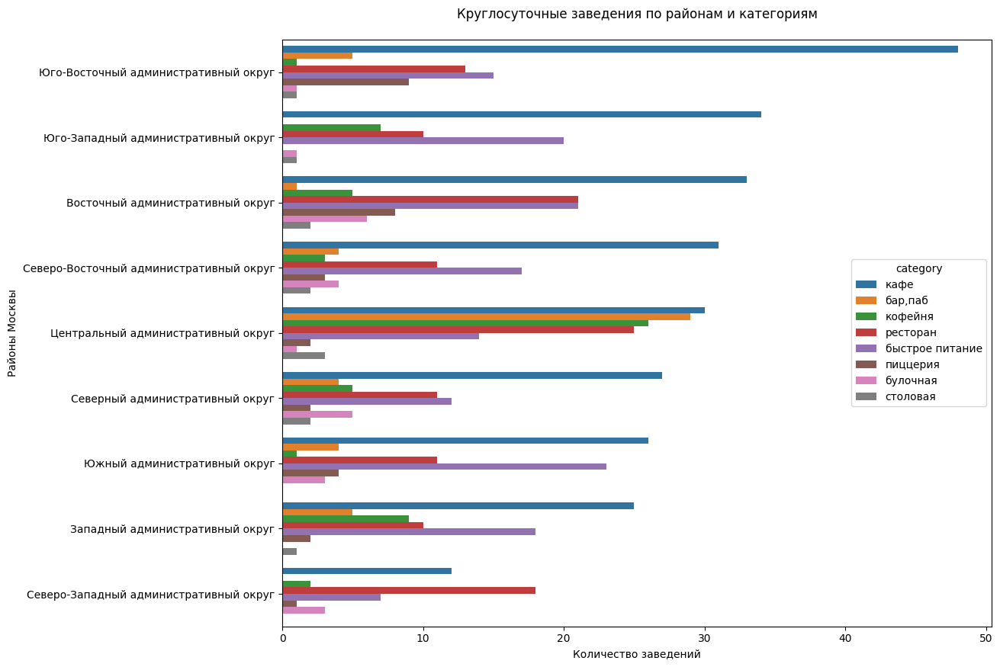

In [29]:
print('Количество круглосуточных заведений в датасете:')
is_24_7 = df.groupby(['is_24_7']).agg({'name':'count'}).reset_index()
is_24_7['%'] = round(is_24_7['name']/is_24_7['name'].sum(),2)
display(is_24_7)
print(60*'=-')

df_is_24=df.query('is_24_7 == True')
df_is_24_group = df_is_24.groupby(['district','category']).agg({'name':'count'}).reset_index()


plt.figure(figsize=(12, 10)) 
sns.barplot(y = 'district', x='name',  data=df_is_24_group.sort_values(by='name', ascending = False), hue='category')
plt.title('Круглосуточные заведения по районам и категориям', pad = 20)
plt.xlabel('Количество заведений')
plt.ylabel('Районы Москвы')
plt.show()

**Промежуточный вывод:**
- 9% всех заведений Москвы являются круглосуточными
- Во всех регионах кроме Северо-западного круглосуточными заведениями чаще всего являются КАФЕ. 
- в Центральном округе, в отличии от других регионов, кроме КАФЕ - много круглосуточных баров, ресторанов и кофеен.
- меньше всего круглосуточных заведений в Северо-западном округе.

<div class="alert alert-info">Круглосуточные заведения на карте</div>

In [30]:
# создаём карту Москвы
m_is_24 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster_is_24 = MarkerCluster().add_to(m_is_24)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters_3(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['category']}",
    ).add_to(marker_cluster_is_24)

# применяем функцию create_clusters() к каждой строке датафрейма
df_is_24.apply(create_clusters_3, axis=1)

# выводим карту
m_is_24

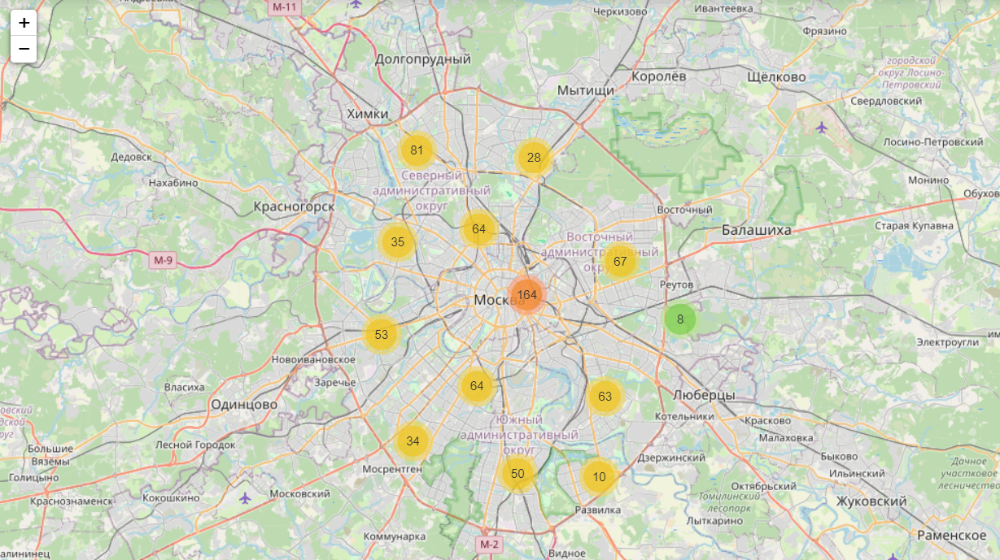

**Промежуточный вывод:**
- распределение круглосуточных заведений на карте - закономерное. В Центре - больше, чем дальше от центра тем меньше. 

<div class="alert alert-info">Заведения с низким рейтингом</div>

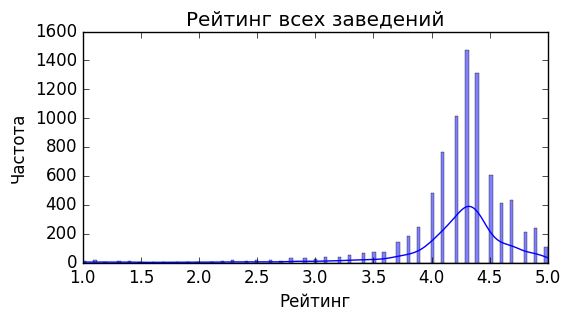

In [31]:
plt.figure(figsize=(6, 3)) 
# назначаем классический стиль для графика с помощью matplotlib
plt.style.use('classic')
# строим гистограмму для столбца total_income, добавив график кривой KDE
sns.histplot(x='rating', data=df, kde=True)
# ограничиваем ось X для наглядности
# указываем заголовок графика и подписи осей средствами matplotlib
plt.title('Рейтинг всех заведений')
plt.xlabel('Рейтинг')
plt.ylabel('Частота')
# отображаем график на экране
plt.show()

**Промежуточный вывод:**
- Для дальнейшего анализа - низким рейтингом назовем рейтинг ниже 4.0

,category,count_low_rating,count_places,%_of_all,%_low_rating
2,быстрое питание,161,603,0.07,26.7
3,кафе,535,2378,0.28,22.5
7,столовая,43,315,0.04,13.7
1,булочная,30,256,0.03,11.7
4,кофейня,136,1413,0.17,9.6
6,ресторан,173,2043,0.24,8.5
5,пиццерия,34,633,0.08,5.4
0,"бар,паб",38,765,0.09,5.0


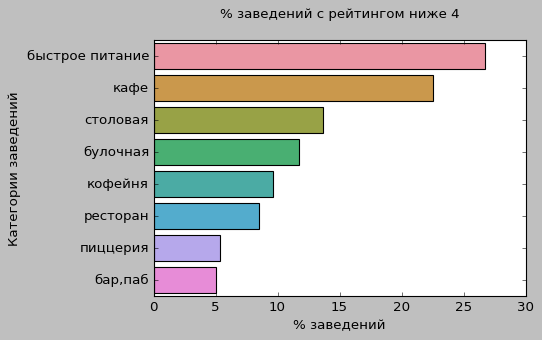

In [32]:
df_low_rating=df.query('rating < 4')
df_low_rating_group = df_low_rating.groupby('category').agg({'name':'count'}).reset_index()
df_low_rating_group=df_low_rating_group.rename(columns={'name': 'count_low_rating'})
df_low_rating_group = df_low_rating_group.merge(category, on='category', how='inner') 
df_low_rating_group['%_low_rating']=round(df_low_rating_group['count_low_rating']/(df_low_rating_group['count_places'])*100, 1)
df_low_rating_group = df_low_rating_group.sort_values(by='%_low_rating', ascending = False)
display(df_low_rating_group)

plt.figure(figsize=(6, 4)) 
sns.barplot(x = '%_low_rating', y='category',  data=df_low_rating_group)
plt.title('% заведений с рейтингом ниже 4', size='medium', pad = 20)
plt.xlabel('% заведений')
plt.ylabel('Категории заведений')
plt.show()

**Промежуточный вывод:**
- Чаще всего посетителей разочаровывают заведения быстрого питания. Более 26% с рейтингом ниже 4.
- Так же с низким рейтингом около 22% КАФЕ .
- Бары и Пиццерии реже всего бывают с низким рейтингом. только около 5% заведений.

<div class="alert alert-info">Исследование среднего чека у заведений с низким рейтингом</div>

,category,avg_bill_low_rating,avg_bill_all_places,%
6,ресторан,475.0,1250.0,62.0
0,"бар,паб",582.5,1250.0,53.4
4,кофейня,300.0,400.0,25.0
1,булочная,337.5,442.5,23.7
5,пиццерия,500.0,600.0,16.7
3,кафе,475.0,550.0,13.6
7,столовая,272.5,300.0,9.2
2,быстрое питание,342.5,375.0,8.7


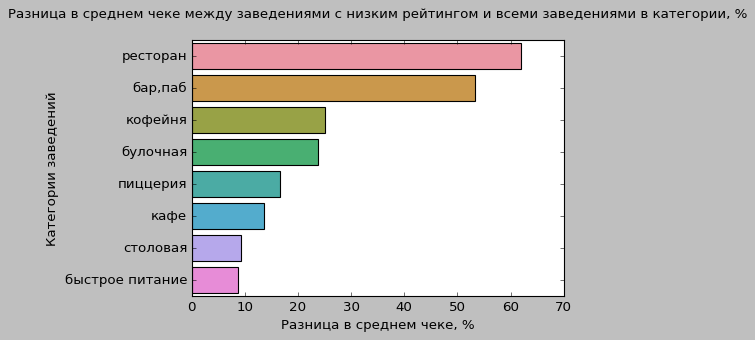

In [33]:
avg_bill_category = df.groupby(['category']).agg({'middle_avg_bill':'median'}).reset_index()
avg_bill_category_low_rating = df_low_rating.groupby(['category']).agg({'middle_avg_bill':'median'}).reset_index()
avg_bill_category_low_rating = avg_bill_category_low_rating.merge(avg_bill_category, on='category', how='inner') 
avg_bill_category_low_rating=avg_bill_category_low_rating.rename(columns={'middle_avg_bill_x': 'avg_bill_low_rating', 'middle_avg_bill_y': 'avg_bill_all_places'})
avg_bill_category_low_rating['%']=round(100 - avg_bill_category_low_rating['avg_bill_low_rating']/(avg_bill_category_low_rating['avg_bill_all_places'])*100 , 1)
avg_bill_category_low_rating = avg_bill_category_low_rating.sort_values(by='%', ascending=False)
display(avg_bill_category_low_rating)

plt.figure(figsize=(6, 4)) 
sns.barplot(x = '%', y='category',  data=avg_bill_category_low_rating)
plt.title('Разница в среднем чеке между заведениями с низким рейтингом и всеми заведениями в категории, %', size='medium', pad = 20)
plt.xlabel('Разница в среднем чеке, %')
plt.ylabel('Категории заведений')
plt.show()

**Промежуточный вывод:**
- Самая сильная разница в средний чеках у категорий РЕСТОРАНЫ и БАРЫ - разница в 50-60%!!!
- В Кофейнях, булочных и пиццериях при рейтинге ниже 4 - чек в среднем ниже на 20-30%.
- У Быстрого питания, столовых и кафе чек отличается на 10-15%.

<a id="conclusion3"></a> 
**Вывод по разделу "Анализ данных":**

**Количество объектов общественного питания по категориям**
- самые частые категории заведений : КАФЕ, РЕСТОРАНЫ и КОФЕЙНИ. - это почти 70% всех заведений столицы.
- самая большая категория заведений с столице - КАФЕ. Более 2300 заведений и 28% от всех заведений.
- далее следует категория РЕСТОРАНЫ. Чуть больше 2000 заведений. (24% от всех заведений)
- КОФЕЙНИ - 1400 заведений. (17% от всех заведений)
- БАРЫ, ПИЦЦЕРИИ, БЫСТРОЕ ПИТАНИЕ - от 600 до 750 заведений каждой категории.- в сумме 24% от всех заведений
- меньше всего в столице СТОЛОВЫХ и БУЛОЧНЫХ - 250-300 заведений каждой категории. - в сумме около 7%

**Количество посадочных мест в заведениях по категориям**
- больше всего посадочных мест у : РЕСТОРАНОВ, БАРОВ, КОФЕЕН и СТОЛОВЫХ. - от 70 до 80.
- у ресторанов БЫСТРОГО ПИТАНИЯ и КАФЕ - около 60 мест.
- в ПИЦЦЕРИЯХ и БУЛОЧНЫХ - 50 мест.

**Соотношение сетевых и несетевых заведений в датасете:**
- Сетевых заведений - около 3 тыс. - 37,5% от всех заведений
- НЕсетевых больше - около 5 тыс. - 62,5% от всех заведений
- Самая высокая ДОЛЯ сетевых заведений у БУЛОЧНЫХ(около 60%), ПИЦЦЕРИЙ(около 50%) и КОФЕЕН(около 50%).
- Самая маленькая доля сетевых заведений у БАРОВ (чуть больше 20%)


**ТОП 15 сетевых заведениями Москвы, по количеству точек**
- КОФЕЙНИ - 6 сетей: 341 точка
- РЕСТОРАНЫ - 3 сети: 150 точек
- ПИЦЦЕРИИ - 2 сети:  149 точек
- КАФЕ - 3 сети: 87 точек
- БУЛОЧНЫЕ 1 сеть: 25 точек

**Распределение популярных сетевых точек по округам:**
- в КАЖДОМ округе, кроме Юго-Восточного - преобладает количество кофеен над другими категориями заведений. В Юго-Восточном -всего 15 кофеен. Вероятно это точка роста для округа, учитывая популярность данной категории. Так же тут нет сетевых точек быстрого питания и булочных.
- В Северо - западном округе практически нет сетевых КАФЕ(1 место). Сетевых ресторанов представлено намного меньше, чем в других округах.
- В Юго-западном отсутствуют сетевые точки быстрого питания. и только 1 точка категории БУЛОЧНЫЕ.
- В Восточном округе - практически нет сетевых КАФЕ(2 места) и отсутствуют сетевые точки быстрого питания. и только 1 точка категории БУЛОЧНЫЕ.
- в Южном округе нет сетевых точек быстрого питания и булочных.
- в Северо-восточном и Западном округах есть все категории сетевых популярных заведений.
- в Северном округе отсутствуют сетевые точки быстрого питания.
- в Центральном округе КОФЕЕН, ресторанов и кафе примерно в 2-3 раза больше чем в других округах, что закономерно - это центр города. Зато пиццерий, булочных и быстрого питания меньше чем в остальных районах.

**Распределение всех заведений по округам**
- по сравнению с распределением популярных сетевых точек доля КОФЕЕЕН, относительно других категорий, сильно снизилась, что говорит о том, что большинство КОФЕЕН - это сети. А вот ресторанов и кафе много НЕсетевых или состоящих в маленьких сетях.
- в целом соотношение заведений по округам примерно одинаковое, за исключением Центрального округа и Северозападного.
- в Центральном ВСЕХ категорий заведений в разы больше, что закономерно. В Северозападном - намного меньше, чем в остальных округах.

**Рейтинги заведений по категориям**
- Разброс средних рейтингов у разных категорий заведений НЕБОЛЬШОЙ. от 4 до 4,4.
- Самые высокие рейтинги у БАРОВ
- Самые низкие у БЫСТРОГО ПИТАНИЯ.

**Рейтинги заведений по округам**
- Самый высокий средний рейтинг у Центрального округа.
- Далее идет Северный и Северозападный округ.
- Самые низкие рейтинги у Южно-восточного округа.

**Самые популярные улицы по количеству заведений**
- проспект Мира - 184 заведения
- Профсоюзная улица - 122 заведения
- Ленинский проспект - 101 заведение
- проспект Вернадского - 97 заведений
- Варшавское шоссе - 73 заведения
- Ленинградский проспект - 72 заведения
- Дмитровское шоссе - 71 заведение
- Ленинградское шоссе - 70 заведений
- Каширское шоссе - 67 заведений 
- МКАД - 65 заведений 
- Люблинская улица - 60 заведений 
- Кутузовский проспект - 53 заведения
- улица Вавилова - 53 заведения
- Пятницкая улица - 48 заведений
- Алтуфьевское шоссе - 47 заведений 

**Обьекты, которые являются единственными заведениями питания на улицах**
- на улицах где есть только 1 заведение - это чаще всего КАФЕ. - в 160 случаях.
- на втором и третьем месте по частоте - РЕСТОРАНЫ - на 93ех улицах и КАФЕЙНИ на 85ти улицах.
- обьекты распределены по карте примерно так же как и остальные. В центре чаще - по окраинам - реже. Это может быть связано с тем, что в центре много маленьких улочек.

**Средний чек заведений**
- Самые высокие чеки у баров и ресторанов - 1100-1150руб
- Кафе и пиццерии - 525-600 руб
- Кафейни и булочные - 400-425 руб
- Столовые и быстрое питание 300-337 руб

**Средний чек заведений в зависимости от района по категориям**
- во всех округах самые высокие средние чеки у баров и ресторанов.
- В Центральном округе средний чек в барах, ресторанах ,булочных, пиццериях намного выше чем в других округах.
- Быстрое питание, столовые и кафейне во всех округах примерно на одном ценовом уровне.

**Круглосуточные заведения**
- 9% всех заведений Москвы являются круглосуточными
- Во всех регионах кроме Северо-западного круглосуточными заведениями чаще всего являются КАФЕ.
- в Центральном округе, в отличии от других регионов, кроме КАФЕ - много круглосуточных баров, ресторанов и кофейн.
- меньше всего круглосуточных заведений в Северо-западном округе.
- распределение круглосуточных заведений на карте - закономерное. В Центре - больше, чем дальше от центра тем меньше.

**Заведения с низким рейтингом**
- Для дальнейшего анализа - низким рейтингом назовем рейтинг ниже 4.0
- Чаще всего посетителей разочаровывают заведения быстрого питания. Более 26% с рейтингом ниже 4.
- Так же с низким рейтингом около 22% КАФЕ .
- Бары и Пиццерии реже всего бывают с низким рейтингом. только около 5% заведений.

**Cредний чек у заведений с низким рейтингом и нормальным**
- Самая сильная разница в средний чеках у категорий РЕСТОРАНЫ и БАРЫ - разница в 50-60%!!!
- В Кофейнях, булочных и пиццериях при рейтинге ниже 4 - чек в среднем ниже на 20-30%.
- У Быстрого питания, столовых и кафе чек отличается на 10-15%.

<a id="coffee_shops"></a>
## Детализированое исследование: открытие кофейни

<div class="alert alert-info">Средняя цена чашки кофе. Исследуем выбросы</div>

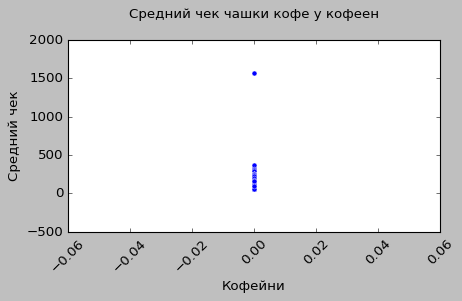

In [34]:
plt.figure(figsize=(6, 3))  
sns.scatterplot(x='category'=='кофейня', y='middle_coffee_cup', data=df)
plt.title('Средний чек чашки кофе у кофеен',size='medium',  pad = 20)
plt.xlabel('Кофейни')
plt.ylabel('Средний чек')
#plt.ylim(0, 400)
plt.xticks(rotation=45)
plt.show()

Видим выбросы от которых следует избавится для дальнейшего анализа. Уберем из базы все кофейни со средней чашкой кофе выше 400

Количество строк ДО удаление выбросов: 8406
Количество строк ПОСЛЕ удаление выбросов: 8208


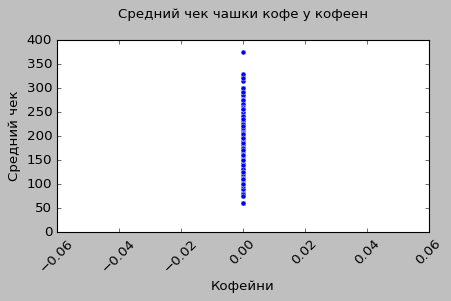

In [35]:
df = df.query('middle_coffee_cup < 400 or middle_coffee_cup.isnull()')

print(f'Количество строк ДО удаление выбросов: {original_length}')
print(f'Количество строк ПОСЛЕ удаление выбросов: {len(df)}')

plt.figure(figsize=(6, 3))  
sns.scatterplot(x='category'=='кофейня', y='middle_coffee_cup', data=df)
plt.title('Средний чек чашки кофе у кофеен',size='medium',  pad = 20)
plt.xlabel('Кофейни')
plt.ylabel('Средний чек')
#plt.ylim(0, 400)
plt.xticks(rotation=45)
plt.show()

**Промежуточный вывод:**
- Выбросы удалены. Можно приступать к анализу

<div class="alert alert-info">Количество кофеен. Средняя цена чашки кофе. Средний рейтинг. ПО ОКРУГАМ</div>

Всего в Москве: 1384 кофеен
Из них: 59 - круглосуточные
Средний рейтинг кофеен Москвы - 4.28

Количество кофеен в каждом округе:


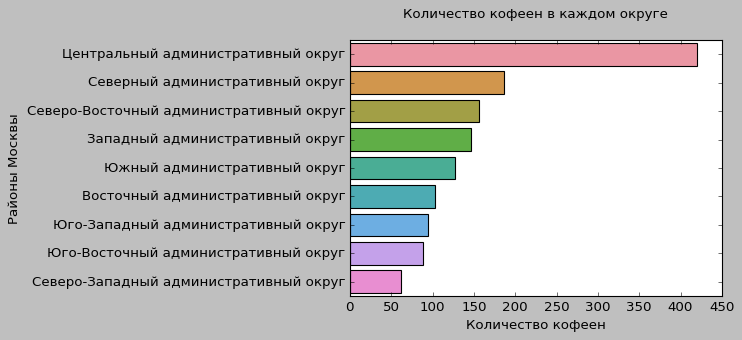

Средняя цена чашки кофе по округам: 


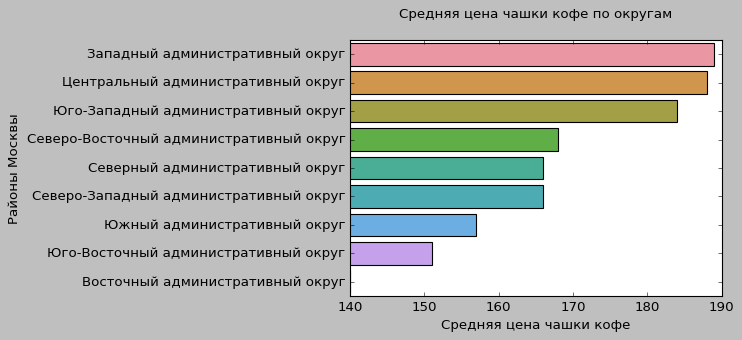

Средний рейтинг кофеен по округам: 


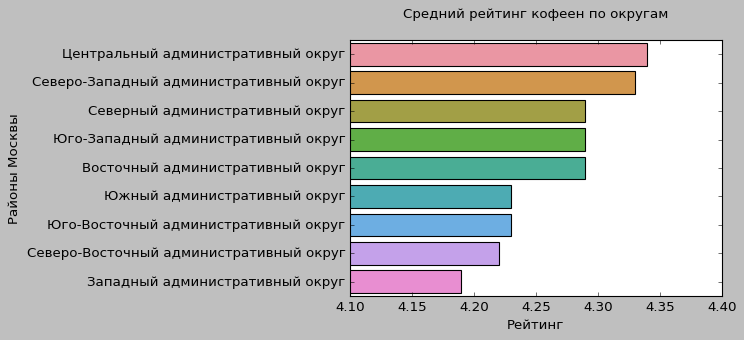

In [36]:
count_coffeу = df.query('category == "кофейня"')['name'].count()
print(f'Всего в Москве: {count_coffeу} кофеен')
coffee_24 = df.query('category == "кофейня" and is_24_7 == True')['name'].count()
print(f'Из них: {coffee_24} - круглосуточные')
coffee_raiting = round(df.query('category == "кофейня"')['rating'].mean(),2)
print(f'Средний рейтинг кофеен Москвы - {coffee_raiting}')
print('')

print('Количество кофеен в каждом округе:')
count_coffee = round( df.query('category == "кофейня"').groupby('district').agg({'name':'count'}).reset_index().sort_values(by='name', ascending = False))

plt.figure(figsize=(6, 4)) 
sns.barplot(x = 'name', y='district',  data=count_coffee)
plt.title('Количество кофеен в каждом округе', size='medium', pad = 20)
plt.xlabel('Количество кофеен')
plt.ylabel('Районы Москвы')
#plt.xlim(140, 190)
plt.show()

print('Средняя цена чашки кофе по округам: ')
middle_coffee_cup = round( df.query('category == "кофейня"').groupby('district').agg({'middle_coffee_cup':'mean'}).reset_index().sort_values(by='middle_coffee_cup', ascending = False))

plt.figure(figsize=(6, 4)) 
sns.barplot(x = 'middle_coffee_cup', y='district',  data=middle_coffee_cup)
plt.title('Средняя цена чашки кофе по округам', size='medium', pad = 20)
plt.xlabel('Средняя цена чашки кофе')
plt.ylabel('Районы Москвы')
plt.xlim(140, 190)
plt.show()

print('Средний рейтинг кофеен по округам: ')
rating_coffee = round( df.query('category == "кофейня"').groupby('district').agg({'rating':'mean'}).reset_index().sort_values(by='rating', ascending = False),2)
plt.figure(figsize=(6, 4)) 
sns.barplot(x = 'rating', y='district',  data=rating_coffee)
plt.title('Средний рейтинг кофеен по округам', size='medium', pad = 20)
plt.xlabel('Рейтинг')
plt.ylabel('Районы Москвы')
plt.xlim(4.1, 4.4)
plt.show()


**Промежуточный вывод:**
- Всего в Москве: 1385 кофеен
- Из них: 59 - круглосуточные
- Средний рейтинг кофеен Москвы - 4.28

**Количество кофеен по округам:**
- Больше всего кофеен в Центральном округе - более чем 400 точек.
- В Западном, Северо-восточном и Северном - по 150-200 точек.
- Меньше всего кофеен в Северозападном округе - чуть больше 50 точек.

**Цена чашки кофе по округам:**
- Самый дорогой кофе в Центральном, Западном и Юго-Западном округах - 185-190р.
- Самый дешевый в Юго-восточном и Южном округах - 150-155р.
- При открытии кофейни можно ориентироваться на среднюю цену чашки в районе открытия кофейни.

**Рейтинг кофеен:**
- В Центральном и Северозападной округе самый высокий рейтинг  - около 4,35
- В Западном округе самый низкий - ниже 4,2
- Разброс рейтингов по округам небольшой от 4,18 до 4,35.

<div class="alert alert-info">Расположение кофеен на карте</div>

In [37]:
# создаём карту Москвы
m_coffee = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster_coffee = MarkerCluster().add_to(m_coffee)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters_4(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['category']}",
    ).add_to(marker_cluster_coffee)

# применяем функцию create_clusters() к каждой строке датафрейма
df.query('category == "кофейня"').apply(create_clusters_4, axis=1)

# выводим карту
m_coffee

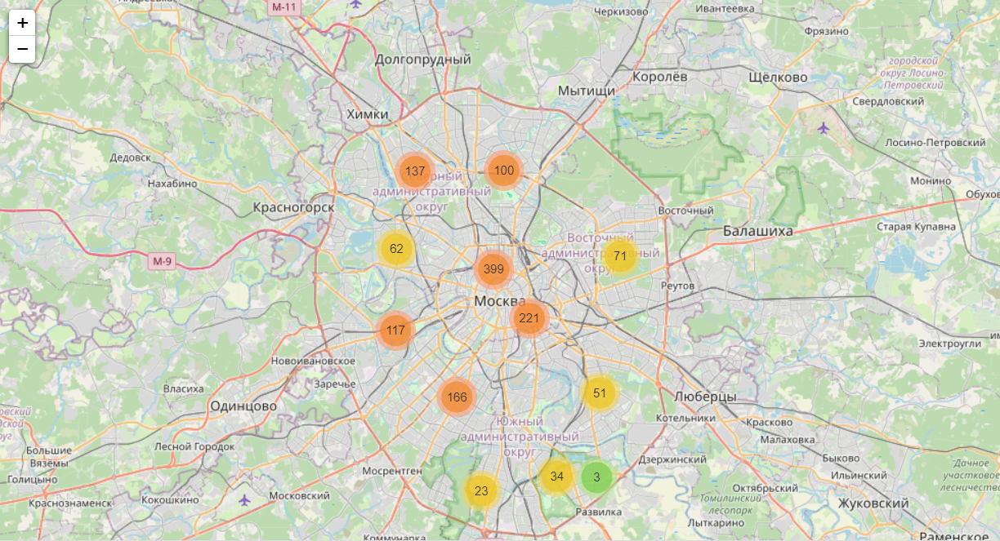

**Промежуточный вывод:**
- на карте, как и на графике видим, что в Южном и Южно-Восточном округе кофеен значительно меньше, чем в остальных округах.
- Центральный округ насчитывает больше всего кофейн, что закономерно учитывая расположение.

<a id="conclusion4"></a> 
**Вывод по разделу "Детализированое исследование: открытие кофейни":**

- Всего в Москве: 1385 кофеен
- Из них: 59 - круглосуточные
- Средний рейтинг кофеен Москвы - 4.28

**Количество кофеен по округам:**
- Больше всего кофеен в Центральном округе - более чем 400 точек.
- В Западном, Северо-восточном и Северном - по 150-200 точек.
- Меньше всего кофеен в Северозападном округе - чуть больше 50 точек.

**Цена чашки кофе по округам:**
- Самый дорогой кофе в Центральном, Западном и Юго-Западном округах - 185-190р.
- Самый дешевый в Юго-восточном и Южном округах - 150-155р.
- При открытии кофейни можно ориентироваться на среднюю цену чашки в районе открытия кофейни.

**Рейтинг кофеен:**
- В Центральном и Северозападной округе самый высокий рейтинг  - около 4,35
- В Западном округе самый низкий - ниже 4,2
- Разброс рейтингов по округам небольшой от 4,18 до 4,35.

**Распределение на карте**
- на карте, видим, что в Южном и Южно-Восточном округе кофеен значительно меньше, чем в остальных округах.
- Центральный округ насчитывает больше всего кофеен, что закономерно учитывая расположение.

<a id="general_conclusion"></a>
## Итоги и выводы по результатам исследования

<div class="alert alert-info"><b>1. Загрузика данныx и изучение общей информации</b></div>
- Всего в датасете представлено 8406 записей
- Количество уникальных заведений: 5614

**В таблице представленно 14 столбцов:**
- name — название заведения;
- address — адрес заведения;
- category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- hours — информация о днях и часах работы;
- lat — широта географической точки, в которой находится заведение;
- lng — долгота географической точки, в которой находится заведение;
- rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона, например
- middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
- middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
- chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки);
- district — административный район, в котором находится заведение, например Центральный административный округ;
- seats — количество посадочных мест.

*Все типы столбцов соответствуют предоставленной в них информации.*

<div class="alert alert-info"><b>2. Предобработка данных</b></div>
    
- дубликатов в записях нет
- пропуски есть в столбцах: hours(6 %), price(61 %), avg_bill(55 %), middle_avg_bill(63 %), middle_coffee_cup(94 %), seats(43 %).
- заполнять пропуски пока не будем, так как вся информация уникальна для каждого заведения.
- добавлен столбец **street** с названиями улиц
- добавлен столбец **is_24/7** с обозначением, что заведение работает ежедневно и круглосуточно (24/7)

**По ходу исследования были найдены и удалены выбросы из столбцов:**
- seats - удалены все заведения с количеством место более чем 350.
- middle_coffee_cup - удалены кофейни со средней ценой за чашку кофе выше 400руб.

- До удаление выбросов таблица насчитывала : 8406 строк. После удаления: 8061 строка. Итого в ходе анализа было удалено 4,1 % базы.

<div class="alert alert-info"><b>3. Анализ данных</b></div>

**Количество объектов общественного питания по категориям**
- самые частые категории заведений : КАФЕ, РЕСТОРАНЫ и КОФЕЙНИ. - это почти 70% всех заведений столицы.
- самая большая категория заведений с столице - КАФЕ. Более 2300 заведений и 28% от всех заведений.
- далее следует категория РЕСТОРАНЫ. Чуть больше 2000 заведений. (24% от всех заведений)
- КОФЕЙНИ - 1400 заведений. (17% от всех заведений)
- БАРЫ, ПИЦЦЕРИИ, БЫСТРОЕ ПИТАНИЕ - от 600 до 750 заведений каждой категории.- в сумме 24% от всех заведений
- меньше всего в столице СТОЛОВЫХ и БУЛОЧНЫХ - 250-300 заведений каждой категории. - в сумме около 7%

**Количество посадочных мест в заведениях по категориям**
- больше всего посадочных мест у : РЕСТОРАНОВ, БАРОВ, КОФЕЙН и СТОЛОВЫХ. - от 70 до 80.
- у ресторанов БЫСТРОГО ПИТАНИЯ и КАФЕ - около 60 мест.
- в ПИЦЦЕРИЯХ и БУЛОЧНЫХ - 50 мест.

**Соотношение сетевых и несетевых заведений в датасете:**
- Сетевых заведений - около 3 тыс. - 37,5% от всех заведений
- НЕсетевых больше - около 5 тыс. - 62,5% от всех заведений

- Самая высокая ДОЛЯ сетевых заведений у БУЛОЧНЫХ(около 60%), ПИЦЦЕРИЙ(около 50%) и КОФЕЕН(около 50%).
- Самая маленькая доля сетевых заведений у БАРОВ (чуть больше 20%)


**ТОП 15 сетевых заведениями Москвы, по количеству точек**
- КОФЕЙНИ - 6 сетей: 341 точка
- РЕСТОРАНЫ - 3 сети: 150 точек
- ПИЦЦЕРИИ - 2 сети:  149 точек
- КАФЕ - 3 сети: 87 точек
- БУЛОЧНЫЕ 1 сеть: 25 точек

**Распределение популярных сетевых точек по округам:**
- в КАЖДОМ округе, кроме Юго-Восточного - преобладает количество кофеен над другими категориями заведений. В Юго-Восточном -всего 15 кофеен. Вероятно это точка роста для округа, учитывая популярность данной категории. Так же тут нет сетевых точек быстрого питания и булочных.
- В Северо - западном округе практически нет сетевых КАФЕ(1 место). Сетевых ресторанов представлено намного меньше, чем в других округах.
- В Юго-западном отсутствуют сетевые точки быстрого питания. и только 1 точка категории БУЛОЧНЫЕ.
- В Восточном округе - практически нет сетевых КАФЕ(2 места) и отсутствуют сетевые точки быстрого питания. и только 1 точка категории БУЛОЧНЫЕ.
- в Южном округе нет сетевых точек быстрого питания и булочных.
- в Северо-восточном и Западном округах есть все категории сетевых популярных заведений.
- в Северном округе отсутствуют сетевые точки быстрого питания.
- в Центральном округе КОФЕЕН, ресторанов и кафе примерно в 2-3 раза больше чем в других округах, что закономерно - это центр города. Зато пиццерий, булочных и быстрого питания меньше чем в остальных районах.

**Распределение всех заведений по округам**
- по сравнению с распределением популярных сетевых точек доля КОФЕЙН, относительно других категорий, сильно снизилась, что говорит о том, что большинство КОФЕИН - это сети. А вот ресторанов и кафе много НЕсетевых или состоящих в маленьких сетях.
- в целом соотношение заведений по округам примерно одинаковое, за исключением Центрального округа и Северозападного.
- в Центральном ВСЕХ категорий заведений в разы больше, что закономерно. В Северозападном - намного меньше, чем в остальных округах.

**Рейтинги заведений по категориям**
- Разброс средних рейтингов у разных категорий заведений НЕБОЛЬШОЙ. от 4 до 4,4.
- Самые высокие рейтинги у БАРОВ
- Самые низкие у БЫСТРОГО ПИТАНИЯ.

**Рейтинги заведений по округам**
- Самый высокий средний рейтинг у Центрального округа.
- Далее идет Северный и Северозападный округ.
- Самые низкие рейтинги у Южно-восточного округа.

**Самые популярные улицы по количеству заведений**
- проспект Мира - 184 заведения
- Профсоюзная улица - 122 заведения
- Ленинский проспект - 101 заведение
- проспект Вернадского - 97 заведений
- Варшавское шоссе - 73 заведения
- Ленинградский проспект - 72 заведения
- Дмитровское шоссе - 71 заведение
- Ленинградское шоссе - 70 заведений
- Каширское шоссе - 67 заведений 
- МКАД - 65 заведений 
- Люблинская улица - 60 заведений 
- Кутузовский проспект - 53 заведения
- улица Вавилова - 53 заведения
- Пятницкая улица - 48 заведений
- Алтуфьевское шоссе - 47 заведений 

**Обьекты, которые являются единственными заведениями питания на улицах**
- на улицах где есть только 1 заведение - это чаще всего КАФЕ. - в 160 случаях.
- на втором и третьем месте по частоте - РЕСТОРАНЫ - на 93ех улицах и КАФЕЙНИ на 85ти улицах.
- обьекты распределены по карте примерно так же как и остальные. В центре чаще - по окраинам - реже. Это может быть связано с тем, что в центре много маленьких улочек.

**Средний чек заведений**
- Самые высокие чеки у баров и ресторанов - 1100-1150руб
- Кафе и пиццерии - 525-600 руб
- Кафейни и булочные - 400-425 руб
- Столовые и быстрое питание 300-337 руб

**Средний чек заведений в зависимости от района по категориям**
- во всех округах самые высокие средние чеки у баров и ресторанов.
- В Центральном округе средний чек в барах, ресторанах ,булочных, пиццериях намного выше чем в других округах.
- Быстрое питание, столовые и кафейне во всех округах примерно на одном ценовом уровне.

**Круглосуточные заведения**
- 9% всех заведений Москвы являются круглосуточными
- Во всех регионах кроме Северо-западного круглосуточными заведениями чаще всего являются КАФЕ.
- в Центральном округе, в отличии от других регионов, кроме КАФЕ - много круглосуточных баров, ресторанов и кофейн.
- меньше всего круглосуточных заведений в Северо-западном округе.
- распределение круглосуточных заведений на карте - закономерное. В Центре - больше, чем дальше от центра тем меньше.

**Заведения с низким рейтингом**
- Для дальнейшего анализа - низким рейтингом назовем рейтинг ниже 4.0
- Чаще всего посетителей разочаровывают заведения быстрого питания. Более 26% с рейтингом ниже 4.
- Так же с низким рейтингом около 22% КАФЕ .
- Бары и Пиццерии реже всего бывают с низким рейтингом. только около 5% заведений.

**Cредний чек у заведений с низким рейтингом и нормальным**
- Самая сильная разница в средний чеках у категорий РЕСТОРАНЫ и БАРЫ - разница в 50-60%!!!
- В Кофейнях, булочных и пиццериях при рейтинге ниже 4 - чек в среднем ниже на 20-30%.
- У Быстрого питания, столовых и кафе чек отличается на 10-15%.
    
    
<div class="alert alert-info"><b>4. Детализированое исследование: открытие кофейни</b></div>

- Всего в Москве: 1385 кофеен
- Из них: 59 - круглосуточные
- Средний рейтинг кофеен Москвы - 4.28

**Количество кофейн по округам:**
- Больше всего кофейн в Центральном округе - более чем 400 точек.
- В Западном, Северо-восточном и Северном - по 150-200 точек.
- Меньше всего кофейн в Северозападном округе - чуть больше 50 точек.

**Цена чашки кофе по округам:**
- Самый дорогой кофе в Центральном, Западном и Юго-Западном округах - 185-190р.
- Самый дешевый в Юго-восточном и Южном округах - 150-155р.
- При открытии кофейни можно ориентироваться на среднюю цену чашки в районе открытия кофейни.

**Рейтинг кофейнь:**
- В Центральном и Северозападной округе самый высокий рейтинг  - около 4,35
- В Западном округе самый низкий - ниже 4,2
- Разброс рейтингов по округам небольшой от 4,18 до 4,35.

**Распределение на карте**
- на карте, видим, что в Южном и Южно-Восточном округе кофейн значительно меньше, чем в остальных округах.
- Центральный округ насчитывает больше всего кофейн, что закономерно учитывая расположение.

<div class="alert alert-info"><b>5. Рекомендации</b></div>

- При открытии кофейни стоит обратить внимание на Западный административный округ. Там самое малое количество кофеен и одна из самых высоких цен на чашку кофе. Также в Западном округе самый низкий рейтинг у  кофеен, что говорит о том, что хороших заведений не хватает, конкуренция невысокая.
- Также можно обратить внимание на Юго-западный округ.  Там также одна из самых дорогих чашек кофе и небольшое количество кофеен.
- Рейтинг кофейни весомо влияет на средний чек, поэтому стоит отслеживать этот показатель.
